# COMP9418 - Assignment 1 - Bayesian Network, Naïve Bayes and TAN Bayes Classifiers

## UNSW Sydney, September 2022

- Student name 1 - zID1
- Student name 2 - zID2

## Instructions

**Submission deadline:** Sunday, 16th October 2022, at 18:00:00 AEDT.

**Late Submission Policy:** The penalty is set at $5\%$ per late day for a maximum of 5 days. This is the UNSW standard late penalty. For example, if an assignment receives an on-time mark of 70/100 and is submitted three days late, it will receive a mark reduction of $70/100*15\%$. After five days, the assignment will receive a mark reduction of $100\%$.

**Form of Submission:** This is an **individual** or group of **two students** assignment. Write the name(s) and zID(s) in this Jupyter notebook. **If submitted in a group, only one member should submit the assignment. Also, create a group on WebCMS by clicking on Groups and Create and include both group members**.

You can reuse any piece of source code developed in the tutorials.

You can submit your solution via [WebCMS](https://webcms3.cse.unsw.edu.au/COMP9418/22T3).

Alternatively, you can submit your solution using give. On a CSE Linux machine, type the following on the command line:

``$ give cs9418 ass1 solution.zip``

## Technical prerequisites

These are the libraries you are allowed to use. No other libraries will be accepted. Make sure you are using Python 3.

In [5]:
# Allowed libraries
import numpy as np
import pandas as pd
import scipy as sp
import heapq as pq
import matplotlib as mp
import math
from itertools import product, combinations
from graphviz import Digraph
from tabulate import tabulate
import copy
from sklearn.model_selection import KFold

We can also use the python files we developed in tutorials or any other code from the tutorials.

In [6]:
from DiscreteFactors import Factor
from Graph import Graph
from BayesNet import BayesNet

## Task 0 - Initialise graph

Create a graph ``G`` that represents the following network by filling in the edge lists.
![Bayes Net](BayesNet.png)


In [7]:
G = Graph({
    "LymphNodes": [],
    'Metastasis': ["LymphNodes"],
    "BC": ["Metastasis","Mass","AD","NippleDischarge","SkinRetract","MC"],
    "Age": ["BC"],
    "Location": ["BC"],
    "MC": [],
    "SkinRetract": [],
    "NippleDischarge": [],
    "AD": ["FibrTissueDev"],
    "FibrTissueDev": ["NippleDischarge","SkinRetract","Spiculation"],
    "Spiculation": ["Margin"],
    "Margin": [],
    "Mass": ["Margin","Shape","Size"],
    "Shape": [],
    "Size": [],
    "BreastDensity": ["Mass"],
})

### Load data

In [8]:
# load data
with open('bc.csv') as file:
    data = pd.read_csv(file)

# remove 2 variables from data (because we are pretending we don't know this information)
if 'Metastasis' in data:
    del data['Metastasis']
if 'LymphNodes' in data:
    del data['LymphNodes']

# remove same 2 nodes from graph
G.remove_node('Metastasis')
G.remove_node('LymphNodes')

## [10 Marks] Task 1 - Efficient d-separation test

Implement the efficient version of the d-separation algorithm in a function ``d_separation(G, X, Z, Y)`` that return a boolean: ``True`` if **X** is d-separated from **Y** given **Z** in the graph $G$ and ``False`` otherwise.

* **X**,**Y** and **Z** are python sets, each containing a set of variable names. 
* Variable names may be strings or integers and can be assumed to be nodes of the graph $G$. 
* $G$ is a directed graph object as defined in tutorial 1.

In [9]:
# Develop your code for d_separation(G, X, Z, Y) in this cell

def find_path_r(start, end, G):
    if start == end:
        return True
    
    G.colour[start] = 'grey'
    
    found = False
    for w in G.adj_list[start]: 
        if G.colour[w] == 'white':
            found = find_path_r(w, end, G)
            
        if found == True:
            break 
            
    return found


def find_path(start, end, G):
    G = copy.deepcopy(G)
    G.colour = {node: 'white' for node in G.adj_list.keys()}
    return find_path_r(start, end, G)


def d_separation(G, X, Z, Y):
    '''
    Arguments:
        G:   is an object of type Graph (the class you developed in tutorial 1).
        X,Z and Y:  are python set objects.
    Returns:
        True if X is d-separared of Y given Z or False otherwise.
    '''

    G1 = G.copy()
    
    for node in G:
        if len(G.adj_list[node]) == 0:            
            if (node not in X) and (node not in Z) and (node not in Y):
                G1.remove_node(node)

    for node in Z:
        G1.adj_list[node] = []
    
    for start in G1:
        for end in G1:
            if start == end:
                continue
            
            if (start in G1.adj_list[end]) and (end not in G1.adj_list[start]):
                G1.adj_list[start].append(end)
    
    for start in X:
        for end in Y:
            has_path = find_path(start, end, G1)
            
            if has_path == True:
                return False
    
    return True

In [10]:
############
## TEST CODE
## Note: More hidden tests will be used. You should make more tests yourself.

def test(statement):
    if statement:
        print("Passed test case")
    else:
        print("Failed test case !!!")
        
test(d_separation(G, set(['Age']), set(['BC']), set(['AD'])))
test(not d_separation(G, set(['Spiculation', 'SkinRetract']), set(['MC', 'Size']), set(['Age'])))

Passed test case
Passed test case


## [5 Marks] Task 2 - Markov blanket

The Markov blanket for a variable $X$ is a set of variables that, when observed, will render every other variable irrelevant to $X$. If the distribution is induced by DAG $G$, then a Markov blanket for variable $X$ can be constructed using $X$'s parents, children, and spouses in $G$. A variable $Y$ is a spouse of $X$ if the two variables have a common child in $G$.

In this exercise, we will implement a function `Markov(G, X)` that returns a python set with the Markov blanket of $X$ in $G$ as described above.

In [11]:
# Develop your code for Markov_blanket(G, X) in this cell

def find_patrents(G, child):
    graphT = G.transpose()
    return graphT.adj_list[child]
    

def Markov_blanket(G, X):
    '''
    Arguments:
        G:   is an object of type Graph (the class you developed in tutorial 1)
        X:   is a node (variable) in G.
    Returns: 
        A python set with the Markov blanked of X in G
    '''
    G = G.copy()
    
    parents = find_patrents(G, X)
    children = G.adj_list[X]
    
    siblings = []
    for child in G.adj_list[X]:
        siblings = siblings + find_patrents(G, child)
    
    blanket = parents + children + siblings
    
    Mb = []
    for node in blanket:
        if node != X:
            Mb.append(node)
    
    Mb = set(Mb)
    
    return Mb

In [12]:
############
## TEST CODE
## Note: More hidden tests will be used. You should make more tests yourself.

def test(statement):
    if statement:
        print("Passed test case")
    else:
        print("Failed test case !!!")

test(Markov_blanket(G, 'Mass') == set(['Margin', 'Size', 'Shape', 'BreastDensity', 'BC', 'Spiculation']))
test(Markov_blanket(G, 'Age') == set(['Location', 'BC']))

Passed test case
Passed test case


## Putting Tasks 1 and 2 together

This task is optional and will not be marked, but you can use it to test your code further. According to the Markov blanket definition: A Markov blanket for a variable $X \in \textbf{X}$ is the set of variables $\textbf{B} \subseteq \textbf{X}$ such that $X \notin \textbf{B}$ and $X \perp \textbf{X} \setminus (\textbf{B} \cup \{ X \}) | \textbf{B}$

In [13]:
# Develop your code to test your d-separation and Markov blanket implementations using the definition above.

set_X = {...}                                        # Set of all nodes in the graph
for X in set_X:
    mb = ...                                         # Markov_blanket of X
    ...                                              # Independence test according to the definition above

## [5 Marks] Task 3 - Learning the outcome space from data

Now, we will implement a series of functions to learn Bayesian network parameters from data. We will start by learning the outcome space of the variables in a Bayesian network. Remind from the tutorials that the outcome space is a python dictionary that maps the variable names to a tuple with the possible values this variable can have.

Implement a function ``learn_outcome_space(dataframe)`` that learns the outcome space (the valid values for each variable) from the pandas dataframe ``dataframe`` and returns a dictionary ``outcomeSpace`` with these values.

In [14]:
# Develop your code for learn_outcome_space(dataframe) in this cell

def learn_outcome_space(dataframe):
    '''
    Arguments:
        dataframe:    A pandas dataframe
    Returns: 
        outcomeSpace: A dictionary. e.g. {'A':('True', 'False'), 'B':('up','down','left'), 'C':(1,2,3,4)}
    '''
    
    outcomeSpace = {}
    for column in dataframe.columns.values:
            outcome_space = []
            for data in dataframe[column]:
                if data not in outcome_space:
                    outcome_space.append(data)
            
            outcomeSpace[column] = tuple(outcome_space)
    
    return outcomeSpace

In [15]:
############
## TEST CODE
## Note: More hidden tests will be used. You should make more tests yourself.

outcomeSpace = learn_outcome_space(data)

outcomes = outcomeSpace['BreastDensity']
answer = ('high', 'medium', 'low')
test(len(outcomes) == len(answer) and set(outcomes) == set(answer))

Passed test case


## [5 Marks] Task 4 - Estimate Bayesian network parameters from data

Implement a method ``model.learn_parameters(dataframe, alpha=1)`` that learns the parameters of the Bayesian Network `model`. This function should do the same as the ``learn_parameters`` function from tutorials, but it should also implement laplacian smoothing with parameter $\alpha$.

In [16]:
## Develop your code for learn_parameters(self, dataframe, alpha) in this cell

class BayesNet(BayesNet):

    def estimateFactor(self, data, var_name, parent_names, outcomeSpace, alpha):
        """
        Calculate a dictionary probability table by ML given
        `data`, a dictionary or dataframe of observations
        `var_name`, the column of the data to be used for the conditioned variable and
        `parent_names`, a tuple of columns to be used for the parents and
        `outcomeSpace`, a dict that maps variable names to a tuple of possible outcomes
        Return a dictionary containing an estimated conditional probability table.
        """    
        var_outcomes = outcomeSpace[var_name]
        parent_outcomes = [outcomeSpace[var] for var in (parent_names)]
        # cartesian product to generate a table of all possible outcomes
        all_parent_combinations = product(*parent_outcomes)

        f = Factor(list(parent_names)+[var_name], outcomeSpace)

        for i, parent_combination in enumerate(all_parent_combinations):
            parent_vars = dict(zip(parent_names, parent_combination))
            parent_index = self.allEqualThisIndex(data, **parent_vars)
            for var_outcome in var_outcomes:
                var_index = (np.asarray(data[var_name])==var_outcome)
                f[tuple(list(parent_combination)+[var_outcome])] = \
                ((var_index & parent_index).sum() + alpha) / (parent_index.sum() + len(outcomeSpace[var_name]) * alpha)

        return f
    
    def learn_parameters(self, dataframe, alpha=1):
        '''
        Arguments:
            data:    A pandas dataframe
            alpha:   Laplacian smoothing parameter
        '''        
        graphT = self.graph.transpose()
        for node, parents in graphT.adj_list.items():
            self.factors[node] = self.estimateFactor(data, node, parents, outcomeSpace, alpha)
            

In [17]:
############
## TEST CODE
## Note: More hidden tests will be used. You should make more tests yourself.

outcomeSpace = learn_outcome_space(data)
model = BayesNet(G, outcomeSpace=outcomeSpace)

model.learn_parameters(data, alpha=1)
l = ('No', 'high', 'No')

test(model.factors['Age']['35-49'] == 0.248000399920016)

Passed test case


## [5 Marks] Task 5 - Bayesian network classification

Design a new method ``model.predict(class_var, evidence)`` that implements the classification with complete data. This function should return the MPE value for the attribute `class_var` given the evidence. As we are working with complete data, `evidence` is an instantiation for all variables in the Bayesian network `model` but `class_var`.

**Implement the efficient classification procedure discussed in the lectures. Assure that you only join the necessary factors.**

In [18]:
## Develop your code for predict(self, class_var, evidence) in this cell

class BayesNet(BayesNet):
    def find_all_joint_probability(self, class_var, class_value, evidence):
        all_values = copy.deepcopy(evidence)
        all_values[class_var] = class_value
        
        mul = 1
        for node in all_values.keys():
            fac = self.factors[node]
            
            l = []
            for d in fac.domain:
                l.append(all_values[d])
            
            l = tuple(l)
            mul *= self.factors[node][l]
        print(mul)
        return mul
    
    
    def get_evidence_probability(self, class_var, evidence):
        probability = 0
        for class_value in self.outcomeSpace[class_var]:
            probability += self.find_all_joint_probability(class_var, class_value, evidence)

        print(probability)
        return probability
        
    
    def predict(self, class_var, evidence):
        '''
        Arguments:
            class_var:   Variable identifier to be classified
            evidence:    Python dictionary with one instantiation to all variables but class_var
        Returns:
            The MPE value (class label) of class_var given evidence
        '''        
        class_probabilities = {}
        for class_value in self.outcomeSpace[class_var]:
            class_probabilities[class_value] = \
            self.find_all_joint_probability(class_var, class_value, evidence) / self.get_evidence_probability(class_var, evidence)
        
        return max(class_probabilities, key=lambda x:class_probabilities[x])

In [19]:
############
## TEST CODE
## Note: More hidden tests will be used. You should make more tests yourself.

outcomeSpace = learn_outcome_space(data)
model = BayesNet(G, outcomeSpace=outcomeSpace)
model.learn_parameters(data, alpha=1)

evidence = {'Age': '35-49', 
    'Location': 'LolwOutQuad', 
    'MC': 'No', 
    'SkinRetract': 'No', 
    'NippleDischarge': 'No',
    'AD': 'No',
    'FibrTissueDev': 'No', 
    'Spiculation': 'No',
    'Margin': 'Well-defined', 
    'Mass': 'No',
    'Shape': 'Other', 
    'Size': '<1cm',
    'BreastDensity': 'high'}

test(model.predict('BC', evidence) == 'No')

0.005593516070411311
0.005593516070411311
1.9163673977958627e-05
4.041072008585506e-05
0.0056530904644751245
1.9163673977958627e-05
0.005593516070411311
1.9163673977958627e-05
4.041072008585506e-05
0.0056530904644751245
4.041072008585506e-05
0.005593516070411311
1.9163673977958627e-05
4.041072008585506e-05
0.0056530904644751245
Passed test case


## [5 Marks] Task 6 - Bayesian network accuracy estimation

Design a new function ``assess_bayes_net(model, dataframe, class_var)`` that uses the test cases in ``dataframe`` to assess the Bayesian network `model` performance at classifying the variable `class_var`. This function will return the accuracy of the Bayesian network according to the examples in ``dataframe``.

Remind that accuracy is the ratio of the number of correct predictions to the total number of cases.

In [20]:
## Develop your code for assess_bayes_net(model, dataframe, class_var) in this cell

# model = BayesNet(...)
def assess_bayes_net(model, dataframe, class_var):
    '''
    Arguments:
        model:     Bayesian Network object
        dataframe: a Pandas dataframe object
        class_var: Variable identifier to be classified
    Returns:
        The accuracy of the Bayesian network model in classifying the cases in dataframe
    '''     
    total_count = 0
    correct_count = 0
    for index, row in dataframe.iterrows():
        total_count += 1
        
        real_bc = row[class_var]
        
        evidence = {}
        for key in row.keys():
            if key != class_var:
                evidence[key] = row[key]
        
        prediction = model.predict(class_var, evidence)
        
        if real_bc == prediction:
            correct_count += 1
        
    return correct_count/total_count

In [21]:
############
## TEST CODE
## Note: More hidden tests will be used. You should make more tests yourself.

model = BayesNet(G, outcomeSpace)
model.learn_parameters(data, alpha=1)

acc = assess_bayes_net(model, data, 'BC')
test(abs(acc-0.8423) < 0.001)

0.00559351607041131
0.00559351607041131
1.9163673977958624e-05
4.041072008585506e-05
0.005653090464475124
1.9163673977958624e-05
0.00559351607041131
1.9163673977958624e-05
4.041072008585506e-05
0.005653090464475124
4.041072008585506e-05
0.00559351607041131
1.9163673977958624e-05
4.041072008585506e-05
0.005653090464475124
4.236731889314604e-08
4.236731889314604e-08
1.7391389597362956e-06
3.11784692866025e-06
4.8993532072896914e-06
1.7391389597362956e-06
4.236731889314604e-08
1.7391389597362956e-06
3.11784692866025e-06
4.8993532072896914e-06
3.11784692866025e-06
4.236731889314604e-08
1.7391389597362956e-06
3.11784692866025e-06
4.8993532072896914e-06
2.036081896159e-07
2.036081896159e-07
8.149846649822069e-08
2.0058176482604885e-07
4.856884209401695e-07
8.149846649822069e-08
2.036081896159e-07
8.149846649822069e-08
2.0058176482604885e-07
4.856884209401695e-07
2.0058176482604885e-07
2.036081896159e-07
8.149846649822069e-08
2.0058176482604885e-07
4.856884209401695e-07
6.798361321945272e-10


## [5 Marks] Task 7 - Bayesian network assessment with cross-validation

Implement a function called `cross_validation_bayes_net(G, dataframe, class_var, k)`, compute and report the average accuracy of the Bayesian network specified by the graph `G` over a $k=10$ cross-validation runs as well as the standard deviation. A scaffold for this function is provided below.

In [22]:
## Develop your code for cross_validation_bayes_net(G, dataframe, class_var, k) in this cell

def cross_validation_bayes_net(G, dataframe, class_var, k=10):
    '''
    Arguments:
        model:      Bayesian Network object
        dataframe:  a Pandas dataframe object
        class_var:  Variable identifier to be classified
        k:          number of cross-validation folds
    Returns:
        The mean accuracy and standand deviation of model across the k folds
    '''      
    accuracy_list = []
    
    kf = KFold(n_splits=k, shuffle = True, random_state = 42)
    for train, test in kf.split(dataframe):
        train_data = dataframe.iloc[train]
        test_data = dataframe.iloc[test]
        
        # train a model with learn_parameters
        outcomeSpace = learn_outcome_space(train_data)
        model = BayesNet(G, outcomeSpace)
        model.learn_parameters(train_data, alpha=1)
        
        # test the model with assess_bayes_net
        acc = assess_bayes_net(model, test_data, class_var)
        
        accuracy_list.append(acc)
        
    return np.mean(accuracy_list), np.std(accuracy_list)

In [23]:
############
## TEST CODE

acc, stddev = cross_validation_bayes_net(G, data, 'BC', 10)
test(abs(acc - 0.85) < 0.05)

6.798361321945272e-10
6.798361321945272e-10
3.1531070573334176e-06
1.753505849167576e-06
4.907292742633188e-06
3.1531070573334176e-06
6.798361321945272e-10
3.1531070573334176e-06
1.753505849167576e-06
4.907292742633188e-06
1.753505849167576e-06
6.798361321945272e-10
3.1531070573334176e-06
1.753505849167576e-06
4.907292742633188e-06
0.0013480207232800074
0.0013480207232800074
3.669914697860142e-06
9.767793932533294e-06
0.001361458431910401
3.669914697860142e-06
0.0013480207232800074
3.669914697860142e-06
9.767793932533294e-06
0.001361458431910401
9.767793932533294e-06
0.0013480207232800074
3.669914697860142e-06
9.767793932533294e-06
0.001361458431910401
0.0022197060990540632
0.0022197060990540632
8.87582853943438e-07
1.0366019962800373e-06
0.0022216302839042864
8.87582853943438e-07
0.0022197060990540632
8.87582853943438e-07
1.0366019962800373e-06
0.0022216302839042864
1.0366019962800373e-06
0.0022197060990540632
8.87582853943438e-07
1.0366019962800373e-06
0.0022216302839042864
9.9991400

## [5 Marks] Task 8 - Naïve Bayes classifier structure

Let's work now with the Naïve Bayes classifier. This classifier is a Bayesian network with a pre-defined structure (graph). Let's start creating a new function, ``learn_naive_bayes_structure(dataframe, class_var)``, that learns the Naïve Bayes graph structure from a pandas `dataframe` using `class_var` as the class variable.

In [24]:
## Develop your code for learn_naive_bayes_structure(dataframe, class_var) in this cell

def learn_naive_bayes_structure(dataframe, class_var):
    '''
    Arguments:
        dataframe:   A pandas dataframe
        class_var:   Variable identifier to be classified
    Returns:
        A Graph object with the structure of the Naïve Bayes classifier for the attributes in dataframe
    '''
    
    graph_dict = {}
    class_variable_children = []
    for variable in dataframe.columns.tolist():
        if variable != class_var:
            class_variable_children.append(variable)
            graph_dict[variable] = []
        
    graph_dict[class_var] = class_variable_children
    
    G = Graph(graph_dict)
    return G

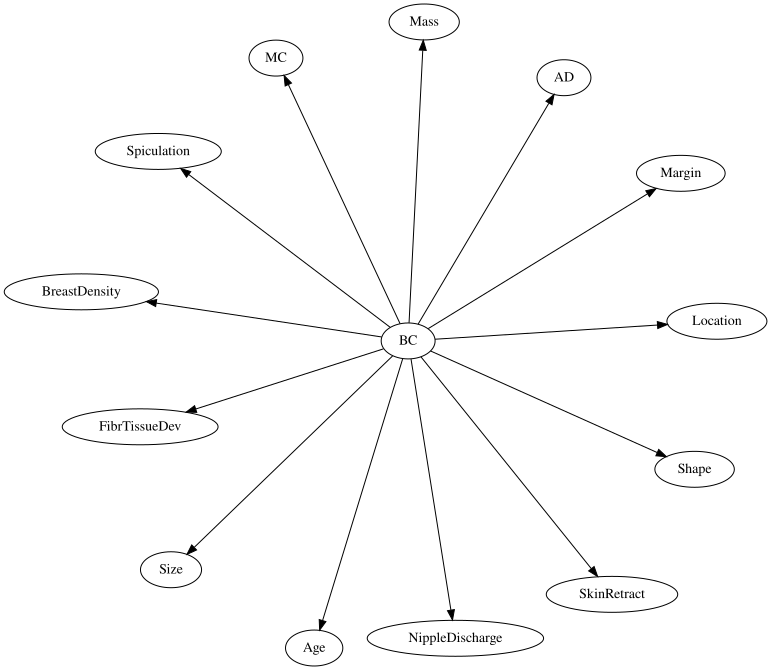

In [25]:
############
## TEST CODE

naiveG = learn_naive_bayes_structure(data, 'BC')
naiveG.show()

## [5 Marks] Task 9 - Naïve Bayes classification

As the Naïve Bayes classifier is a Bayesian network, we can use the existing `BayesNet` class to create a new class `NaiveBayes`.

Let's create a new method ``model.predict_log(class_var, evidence)`` that implements the classification with complete data. This function should return the MPE value for the attribute `class_var` given the `evidence`. As we work with complete data, `evidence` is an instantiation for all variables but `class_var`. **Use the log probability trick discussed in the lectures to classify each example**.

In [26]:
## Develop your code for predict_log(self, class_var, evidence) in this cell

from math import log

class NaiveBayes(BayesNet):
    
    def log_naive_bayse_joint_probability(self, class_var, class_value, evidence):
        all_values = copy.deepcopy(evidence)
        all_values[class_var] = class_value
        
        joint_log_sum = 0
        for node in all_values.keys():
            fac = self.factors[node]
            
            l = []
            for d in fac.domain:
                l.append(all_values[d])
            
            l = tuple(l)
            joint_log_sum += log(self.factors[node][l])
        
        print(class_value, joint_log_sum)
        return joint_log_sum
    
    
    def predict_log(self, class_var, evidence):
        '''
        Arguments:
            class_var:   Variable identifier to be classified
            evidence:    Python dictionary with one instantiation to all variables but class_var
        Returns:
            The MPE value (class label) of class_var given evidence
        '''        

        class_probabilities = {}
        for class_value in self.outcomeSpace[class_var]:
            class_probabilities[class_value] = self.log_naive_bayse_joint_probability(class_var, class_value, evidence)
        
        return max(class_probabilities, key=lambda x:class_probabilities[x])

In [27]:
############
## TEST CODE
## Note: More hidden tests will be used. You should make more tests yourself.

outcomeSpace = learn_outcome_space(data)
naiveG = learn_naive_bayes_structure(data, 'BC')
naive_model = NaiveBayes(naiveG, outcomeSpace=outcomeSpace)
naive_model.learn_parameters(data, alpha=1)
evidence = {'Age': '35-49', 
    'Location': 'LolwOutQuad', 
    'MC': 'No', 
    'SkinRetract': 'No', 
    'NippleDischarge': 'No',
    'AD': 'No',
    'FibrTissueDev': 'No', 
    'Spiculation': 'No',
    'Margin': 'Well-defined', 
    'Mass': 'No',
    'Shape': 'Other', 
    'Size': '<1cm',
    'BreastDensity': 'high'}

test(naive_model.predict_log('BC', evidence) == 'No')

No -6.473736763059178
Invasive -15.93610204724259
Insitu -13.796598082523987
Passed test case


## [5 Marks] Task 10 - Naïve Bayes accuracy estimation

Design a new function ``assess_naive_bayes(model, dataframe, class_var)`` that uses the test cases in ``dataframe`` to assess the performance of the Naïve Bayes classifier for the class variable `class_var`. This function will return the accuracy of the classifier according to the examples in the ``dataframe``.

In [28]:
## Develop your code for assess_naive_bayes(model, dataframe, class_var) in this cell

model = NaiveBayes(...)
def assess_naive_bayes(model, dataframe, class_var='BC'):
    '''
    Arguments:
        model:      Naive Bayes object
        dataframe:  a Pandas dataframe object
        class_var:  Variable identifier to be classified
    Returns:
        The accuracy of the Naive Bayes model in classifying the cases in dataframe
    '''      
    total_count = 0
    correct_count = 0
    for index, row in dataframe.iterrows():
        total_count += 1

        real_bc = row[class_var]

        evidence = {}
        for key in row.keys():
            if key != class_var:
                evidence[key] = row[key]

        prediction = model.predict_log(class_var, evidence)

        if real_bc == prediction:
            correct_count += 1
    
    return correct_count/total_count

In [29]:
############
## TEST CODE
## Note: More hidden tests will be used. You should make more tests yourself.

naive_model = NaiveBayes(naiveG, outcomeSpace)
naive_model.learn_parameters(data, alpha=1)

acc = assess_naive_bayes(naive_model, data, 'BC')
test(abs(acc-0.7926) < 0.001)

No -6.473736763059178
Invasive -15.936102047242592
Insitu -13.796598082523985
No -16.537396063130874
Invasive -14.17741618163218
Insitu -12.634560106656275
No -14.799274268629883
Invasive -14.537218865939135
Insitu -13.83257686798467
No -22.403849099230975
Invasive -13.636326142352639
Insitu -13.336305109352725
No -16.201508540720464
Invasive -19.24594790141486
Insitu -17.231866252787295
No -12.64451910974901
Invasive -14.448775826105965
Insitu -15.380642421996027
No -8.916237253653186
Invasive -12.512776228059353
Insitu -12.762906524124228
No -7.581432268730741
Invasive -13.597525612090449
Insitu -13.432208833554885
No -7.460303257714455
Invasive -19.167983581581368
Insitu -17.1469360516894
No -6.0961318553976795
Invasive -14.398181980350822
Insitu -13.043537901243088
No -28.249623240098195
Invasive -11.752442599837973
Insitu -12.917227373672482
No -7.676388291380657
Invasive -14.974104679009256
Insitu -13.61203490715151
No -10.076941384277383
Invasive -18.315544623101225
Insitu -17.0

## [5 Marks] Task 11 - Naïve Bayes assessment with cross-validation

Implement a function called `cross_validation_naive_bayes(dataframe, class_var, k)`, compute and report the average accuracy over the $k=10$-fold cross-validation runs as well as the standard deviation. A scaffold for this function is provided below.

In [30]:
## Develop your code for cross_validation_naive_bayes(dataframe, class_var, k) in this cell

def cross_validation_naive_bayes(dataframe, class_var='BC', k=10):
    accuracy_list = []
    
    kf = KFold(n_splits=k, shuffle = True, random_state = 42)
    for train, test in kf.split(dataframe):
        train_data = dataframe.iloc[train]
        test_data = dataframe.iloc[test]
        
        # train a model with learn_parameters
        outcomeSpace = learn_outcome_space(train_data)
        naiveG = learn_naive_bayes_structure(train_data, 'BC')
        naive_model = NaiveBayes(naiveG, outcomeSpace)
        naive_model.learn_parameters(train_data, alpha=1)
        
        # test the model with assess_bayes_net
        acc = assess_naive_bayes(naive_model, test_data, class_var)
        
        accuracy_list.append(acc)
        
    return np.mean(accuracy_list), np.std(accuracy_list)   


In [31]:
############
## TEST CODE

acc, stddev = cross_validation_naive_bayes(data, 'BC')
test(abs(acc - 0.80) < 0.05)

No -22.403849099230975
Invasive -13.636326142352639
Insitu -13.336305109352725
No -7.988095220863144
Invasive -14.013981789893833
Insitu -13.866145615744362
No -7.375205652257884
Invasive -19.295743285552824
Insitu -17.35143028122146
No -20.393559054671254
Invasive -12.227071169238496
Insitu -12.422294618332021
No -6.994153856061141
Invasive -18.764578159973475
Insitu -17.010860673043684
No -6.583832327906026
Invasive -15.53974295393021
Insitu -13.897255693427292
No -25.708284219449844
Invasive -11.157622286661049
Insitu -14.278473627475737
No -12.76255857202763
Invasive -14.96027787079033
Insitu -12.020273605083158
No -6.13615529153125
Invasive -15.330583101701999
Insitu -12.896701921802563
No -12.723065424732695
Invasive -13.633059634133062
Insitu -14.576691129863706
No -7.888819478483836
Invasive -13.294049082256926
Insitu -12.724055472496373
No -9.059096376750471
Invasive -14.134364827115082
Insitu -12.681591159612303
No -6.443308358009172
Invasive -14.827688914349698
Insitu -13.77

## [15 Marks] Task 12 - Tree-augmented naïve Bayes structure

Let's work now with the Tree-augmented Naïve Bayes classifier. We will start creating a new function, ``learn_tan_structure(dataframe, class_var)``, that learns the Tree-augmented Bayes graph structure from a pandas dataframe.

In [32]:
## Develop your code for learn_tan_structure(dataframe, class_var) in this cell

def learn_tan_structure(dataframe, class_var):
    '''
    Arguments:
        dataframe - A pandas dataframe
        class_var - Variable identifier to be classified
    Returns:
        A Graph object with the structure of the Naïve Bayes classifier for the attributes in dataframe and class_var
    '''
    ...
    return ...

In [33]:
############
## TEST CODE

tan_graph = learn_tan_structure(data, class_var='BC')
test(len(tan_graph.children('BC')) == len(tan_graph)-1)
test('FibrTissueDev' in tan_graph.children('Spiculation') or 'Spiculation' in tan_graph.children('FibrTissueDev'))

AttributeError: 'ellipsis' object has no attribute 'children'

## [5 Marks] Task 13 - Tree-augmented naïve Bayes assessment with cross-validation

Implement a function called `cross_validation_tan(dataframe, class_var, k)`, compute and report the average accuracy over the $k=10$-fold cross-validation runs and the standard deviation. A scaffold for this function is provided below.

In [ ]:
## Develop your code for cross_validation_tan(dataframe, class_var, k) in this cell

def cross_validation_tan(dataframe, class_var='BC', k=10):
    accuracy_list = []
    
    kf = KFold(n_splits=k, shuffle = True, random_state = 42)
    for train, test in kf.split(dataframe):
      
        # train a model with learn_parameters
        ...
        
        # test the model with assess_bayes_net
        acc = ...
        
        accuracy_list.append(acc)
    return np.mean(accuracy_list), np.std(accuracy_list)   

In [ ]:
############
## TEST CODE

acc, stddev = cross_validation_tan(data, 'BC')
test(abs(acc - 0.83) < 0.05)

## [20 Marks] Task 14 - Report

Write a report (**with less than 500 words**) summarising your findings in this assignment. Your report should address the following:

a. Make a summary and discussion of the experimental results. You can analyse your results from different aspects such as accuracy, runtime, coding complexity and independence assumptions. You can use plots to illustrate your results.

b. Discuss the time and memory complexity of the implemented algorithms.

Use Markdown and Latex to write your report in the Jupyter notebook. Develop some plots using Matplotlib to illustrate your results. Be mindful of the maximum number of words. Please, be concise and objective.

---
Write your report in one or more cells here.

---